# Interpolazione dati cumulativi dei contagi con funzione Gompertz doppia

2020-04 Max Pierini ([info@maxpierini.it](mailto:info@maxpierini.it))

***

La curva dei contagi totali segue una forma approssimativamente sigmoide ([ref]()).

$$ f(x) = \frac{a}{ 1 + \mathbf{e}^{k(b - x)} } +\varepsilon $$

Dall'analisi delle curve interpolate con funzione sigmoide però risulta evidente che la pendenza della curva prima del flesso è differente dalla pendenza dal flesso al massimo ([ref]()).

Due differenti funzioni sigmoidi descrivono più correttamente la curva prima del flesso (Logistic 1) e dopo il flesso (Logistic 2) [ref]().

Una possibile soluzione per interpolare su una funzione che descriva meglio l'andamento della curva viene dalla funzione di Gompertz doppia, utilizzata ad esempio in agraria per la descrizione dell'accrescimento dei frutti ([ref]()).

$$ g(x) = a_1 \mathbf{e}^{ - \mathbf{e^{k_1(b_1 - x)}} } + (a_2 - a_1) \mathbf{e}^{ - \mathbf{e^{k_2(b_2 - x)}} } + \varepsilon $$

L'interpolazione dei dati (laddove siano sufficienti e coerenti) su questa funzione, segue meglio l'andamento della curva dei contagi.

In [1]:
import json
import requests
import urllib.request
import io

from IPython.display import display, Math, Latex, Markdown, clear_output, HTML

import matplotlib.pyplot as plt
from matplotlib.dates import date2num, num2date
from matplotlib import dates as mdates
from matplotlib import ticker
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch

from scipy.optimize import curve_fit
from scipy import stats
import numpy as np
import pandas as pd

In [2]:
def gompertz_func(x, a, b, k, e):
    exp = - np.exp(k * (b - x))    
    return a * np.exp(exp) + e

In [3]:
def double_gompertz(x, a1, b1, k1, a2, b2, k2, e):
    exp1 = - np.exp(k1 * (b1 - x))
    g1 = a1 * np.exp(exp1)
    exp2 = - np.exp(k2 * (b2 - x))
    g2 = (a2 - a1) * np.exp(exp2)
    return g1 + g2 + e

In [4]:
def logistic_func(x, L, b, k, e):
    d = k * (b - np.array(x))
    return (L / (1 + np.exp(d))) + e

In [5]:
def double_logistic(x, a1, b1, k1, a2, b2, k2, e):
    d1 = k1 * (b1 - np.array(x))
    l1 = a1 / (1 + np.exp(d1))
    d2 = k2 * (b2 - np.array(x))
    l2 = (a2 - a1) / (1 + np.exp(d2))
    return l1 + l2 + e

In [6]:
def get_df(_data, country):
    csv = "data,cases\n"
    for i, l in enumerate(_data[country]["Confirmed"]):
        n = _data[country]["Confirmed"][l]
        csv += f"{l},{n}"
        if i < len(_data[country]["Confirmed"]) - 1:
            csv += "\n"
    data = None
    data = pd.read_csv(io.StringIO(csv),
                         usecols=['data', 'cases'],
                         parse_dates=['data'],
                         index_col=['data'],
                         squeeze=True).sort_index()
    return data

In [7]:
def prepare_cases(
    cases, forecast=120, country="Italy",
    method=None, dolog=False):

    popt, pcov = None, None
    
    new_cases = cases.diff()
    max_new_cases = new_cases.argmax()

    if method == "dobgomp":
        popt, pcov = curve_fit(
            double_gompertz,
            [i for i in range(cases.size)],
            cases,
            p0=[
                cases[max_new_cases], max_new_cases, 1,
                max(cases), cases.size, 1,
                cases[0]
            ], maxfev=8000
        )
        _results = double_gompertz([i for i in range(cases.size + forecast)], *popt)
    elif method == "doblogit":
        popt, pcov = curve_fit(
            double_logistic,
            [i for i in range(cases.size)],
            cases,
            p0=[
                cases[max_new_cases], max_new_cases, 1,
                max(cases), cases.size, 1,
                cases[0]
            ], maxfev=8000
        )
        _results = double_logistic([i for i in range(cases.size + forecast)], *popt)
    elif method == "gomp":
        popt, pcov = curve_fit(
            gompertz_func,
            [i for i in range(cases.size)],
            cases,
            p0=[
                cases[max_new_cases], max_new_cases, 1,
                cases[0]
            ], maxfev=8000
        )
        _results = gompertz_func([i for i in range(cases.size + forecast)], *popt)
    elif method == "logit":
        popt, pcov = curve_fit(
            logistic_func,
            [i for i in range(cases.size)],
            cases,
            p0=[
                cases[max_new_cases], max_new_cases, 1,
                cases[0]
            ], maxfev=8000
        )
        _results = logistic_func([i for i in range(cases.size + forecast)], *popt)
    
    
    forecast_index = pd.date_range(cases.index[0], cases.index[0] + pd.Timedelta(days=len(_results) - 1))
    results = pd.Series(
        data=_results, index=forecast_index,
        name=f"{country} cases {method}"
    ).round()
    
    logit1 = None
    logit2 = None
    if dolog:
        poptL1, pcovL1 = curve_fit(
            logistic_func,
            [i for i in range(max_new_cases)],
            cases[:max_new_cases],
            p0=[
                popt[3], max_new_cases, .1, 1
            ],
            method="trf", maxfev=8000
        )

        poptL2, pcovL2 = curve_fit(
            logistic_func,
            [i + max_new_cases for i in range(cases.size - max_new_cases)],
            cases[max_new_cases:],
            p0=[
                popt[3], max_new_cases, .1, 1
            ],
            method="trf", maxfev=8000
        )

        _logistic1 = logistic_func([i for i in range(cases.size + forecast)], *poptL1)
        forecast_index = pd.date_range(cases.index[0], cases.index[0] + pd.Timedelta(days=len(_logistic1) - 1))
        logit1 = pd.Series(
            data=_logistic1, index=forecast_index,
            name=f"{country} cases"
        ).round()

        _logistic2 = logistic_func([i for i in range(cases.size + forecast)], *poptL2)
        forecast_index = pd.date_range(cases.index[0], cases.index[0] + pd.Timedelta(days=len(_logistic2) - 1))
        logit2 = pd.Series(
            data=_logistic2, index=forecast_index,
            name=f"{country} cases"
        ).round()
    
    return cases, results, popt, logit1, logit2

In [8]:
def plot_gompertz(original, gompertz, popt, logit1, logit2, name=""):

    ax1 = plt.subplot(212)
    
    ax1.plot(
        gompertz.index, gompertz.values,
        label='Double Gompertz',
        ls="-.", c="r")
    ax1.scatter(
        original.index, original.values,
        c='w',
        linewidths=1,
        alpha=.5,
        edgecolors="k",
        s=20,
        label='Actual',
    )

    ax2 = plt.subplot(221)
    ax2.plot(
        logit1.index, logit1,
        label="Logistic 1",
        c="c", ls="-."
    )
    ax2.scatter(
        original.index, original.values,
        c='w',
        alpha=.5,
        linewidths=1,
        edgecolors="k",
        s=20,
        label='Actual',
    )
    
    ax3 = plt.subplot(222)
    ax3.plot(
        logit2.index, logit2,
        label="Logistic 2",
        c="g", ls="-."
    )
    ax3.scatter(
        original.index, original.values,
        c='w',
        linewidths=1,
        edgecolors="k",
        alpha=.5,
        s=20,
        label='Actual',
    )


    #ax.axhline(popt[0], linestyle=':', label=f"$a_1$ = {popt[0]:.0f}", c="k")
    ax1.axhline(popt[3], linestyle=':', label=f"$a_2 =$ {popt[3]:.0f}", c="k")

    #ax.axvline(data.index[0] + pd.Timedelta(days=popt[1]), linestyle=':', label=f"$b_1$ = {popt[1]:.2f}")
    #ax.axvline(data.index[0] + pd.Timedelta(days=popt[4]), linestyle='-.', label=f"$b_2$ = {popt[4]:.2f}")
    txt = "$f(x) = a_1 \\mathbf{e}^{ - \\mathbf{e^{k_1(b_1 - x)}} } + (a_2 - a_1) \\mathbf{e}^{ - \\mathbf{e^{k_2(b_2 - x)}} } + \\varepsilon$\n"
    txt +=  f"$a_1 = {popt[0]:.0f}$\n"
    txt += f"$b_1 = {popt[1]:.2f}$\n"
    txt += f"$k_1 = {popt[2]:.4f}$\n"
    txt += f"$a_2 = {popt[3]:.0f}$\n"
    txt += f"$b_2 = {popt[4]:.2f}$\n"
    txt += f"$k_2 = {popt[5]:.4f}$\n"
    txt += f"$\\varepsilon = {popt[6]:.2f}$\n"
    
    plt.text(0.6, 0.4, txt, horizontalalignment='left',
        verticalalignment='center', transform=ax1.transAxes,
        fontsize=13
    )

    ax1.axhline(0.0, c='k', lw=1, alpha=.25);
    ax2.axhline(0.0, c='k', lw=1, alpha=.25);
    ax3.axhline(0.0, c='k', lw=1, alpha=.25);

    ax1.axvline(original.index[int(popt[1])], c='k', lw=1, alpha=.25);
    ax2.axvline(original.index[int(popt[1])], c='k', lw=1, alpha=.25);
    ax3.axvline(original.index[int(popt[1])], c='k', lw=1, alpha=.25);
    
    ax1.axvline(original.index[int(popt[4])], c='k', lw=1, alpha=.25);
    ax2.axvline(original.index[int(popt[4])], c='k', lw=1, alpha=.25);
    ax3.axvline(original.index[int(popt[4])], c='k', lw=1, alpha=.25);
    
    ax1.get_figure().set_facecolor('w')
    ax2.get_figure().set_facecolor('w')
    ax3.get_figure().set_facecolor('w')
    
    ax1.legend(loc='upper left', fontsize=10)
    ax2.legend(loc='upper left', fontsize=10)
    ax3.legend(loc='upper left', fontsize=10)
    
    ax1.set_ylim(- max(gompertz) * .1, max(gompertz) * 1.1)
    ax2.set_ylim(- max(gompertz) * .1, max(gompertz) * 1.1)
    ax3.set_ylim(- max(gompertz) * .1, max(gompertz) * 1.1)
    
    ax3.get_figure().set_size_inches(15, 12)
    
    plt.suptitle(f"{name} cases interpolated on double Gompertz curve", fontsize=20)
    plt.show()
    plt.close("all")

In [9]:
def plot_function(original, interpolated, name="", method=None):

    ax1 = interpolated.plot(
        label=method,
        ls="-.", c="r")
    ax1.scatter(
        original.index, original.values,
        c='w',
        linewidths=1,
        alpha=.5,
        edgecolors="k",
        s=20,
        label='Actual',
    )

    ax1.axhline(0.0, c='k', lw=1, alpha=.25);
    
    ax1.get_figure().set_facecolor('w')
    
    ax1.legend(loc='upper left', fontsize=10)
    
    ax1.set_ylim(- max(interpolated) * .1, max(interpolated) * 1.1)
    
    ax1.get_figure().set_size_inches(15, 10)
    
    plt.suptitle(f"{name} cases interpolated on {method}", fontsize=20)
    plt.show()
    plt.close("all")

In [10]:
def plot_gompertz_mini(original, gompertz, ax, name=""):

    ax.set_title(f"{name}")
    
    ax.scatter(
        original.index, original,
        c='k',
        linewidths=1,
        # edgecolors="k",
        s=7, alpha=.25,
        label='Actual',
    )
    
    ax.plot(
        gompertz.index, gompertz,
        label='Double Gompertz',
        c="r", lw=1, ls="--"
    )

    ax.axhline(0.0, c='k', lw=1, alpha=.25)
    
    # Formatting
    ax.xaxis.set_ticklabels([])
    ax.margins(0)
    ax.set_ylim(- max(gompertz) * .1, max(gompertz) * 1.1)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.margins(0)
    ax.grid(which='major', axis='y', c='k', alpha=.1, zorder=-2)
    fig.set_facecolor('w')

In [11]:
def compute(_data, country, ax, index, method=None):
    data = get_df(_data, country)
    original, interpolated, popt, logit1, logit2 = prepare_cases(data, forecast=0, method=method)
    plot_gompertz_mini(original, interpolated, ax, name=country, index=index)

In [12]:
url = 'https://raw.githubusercontent.com/pcm-dpc/COVID-19/master/dati-andamento-nazionale/dpc-covid19-ita-andamento-nazionale.csv'
data= None
data = pd.read_csv(url,
                     usecols=['data', 'totale_casi'],
                     parse_dates=['data'],
                     index_col=['data'],
                     squeeze=True).sort_index()

Dal grafico dei contagi totali italiani si può notare che
- la funzione `Logistic 1` descrive correttamente la prima parte della curva ma
  - non è in grado di descrivere la curva dopo il flesso
  - porta sicuramente ad una notevole sottostima della previsione dei contagi totali
- la funzione `Logistic 2` descrive correttamente la curva dopo il flesso ma
  - non è in grado di descrivere la curva prima del flesso
  - può portare ad una sovrastima della previsione dei contagi totali
 
Interpolando i dati invece su funzione di Gompertz doppia, la curva è descritta correttamente prima e dopo flesso ed è possibile una maggior precisione nella stima delle previsioni.

In [13]:
original, interpolated, popt, logit1, logit2 = prepare_cases(data, forecast=120, dolog=True, method="dobgomp")

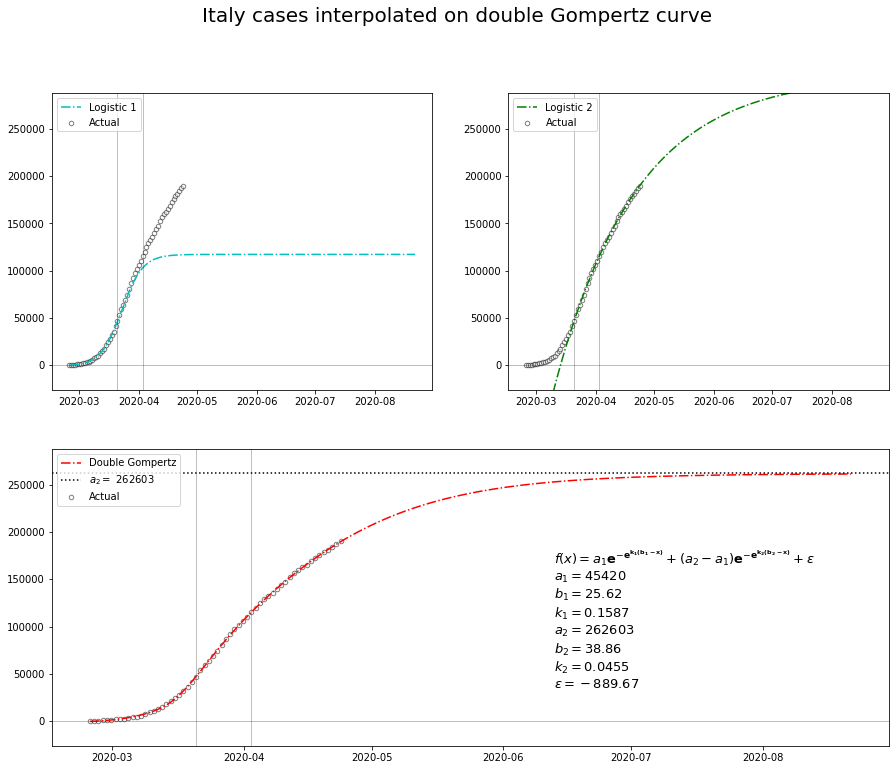

In [14]:
plot_gompertz(original, interpolated, popt, logit1, logit2, name="Italy")

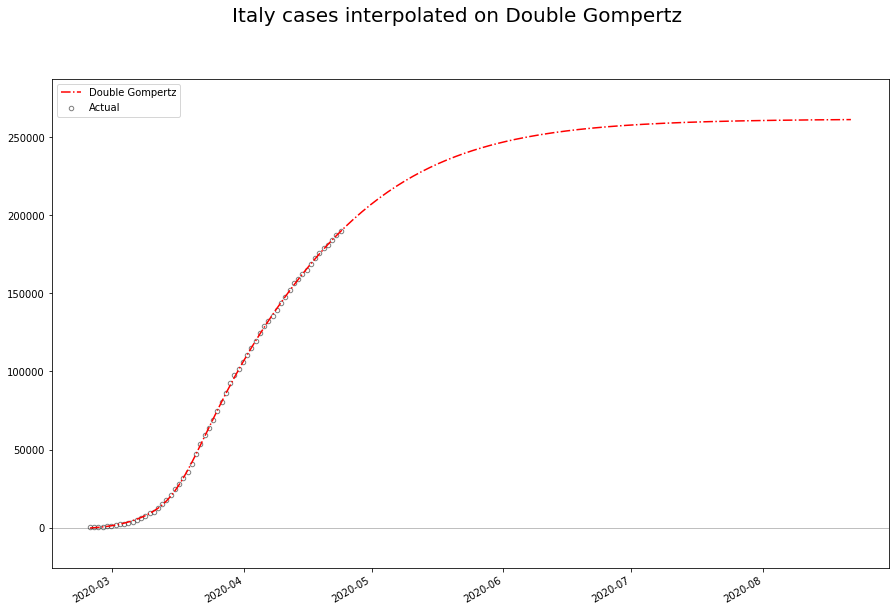

In [15]:
original, interpolated, popt, logit1, logit2 = prepare_cases(data, forecast=120, method="dobgomp")
plot_function(original, interpolated, name="Italy", method="Double Gompertz")

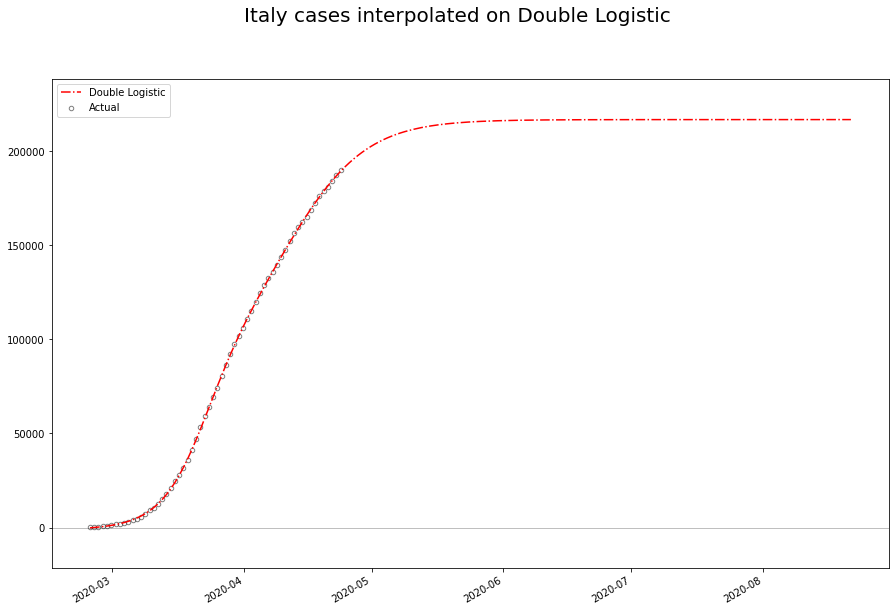

In [16]:
original, interpolated, popt, logit1, logit2 = prepare_cases(data, forecast=120, method="doblogit")
plot_function(original, interpolated, name="Italy", method="Double Logistic")

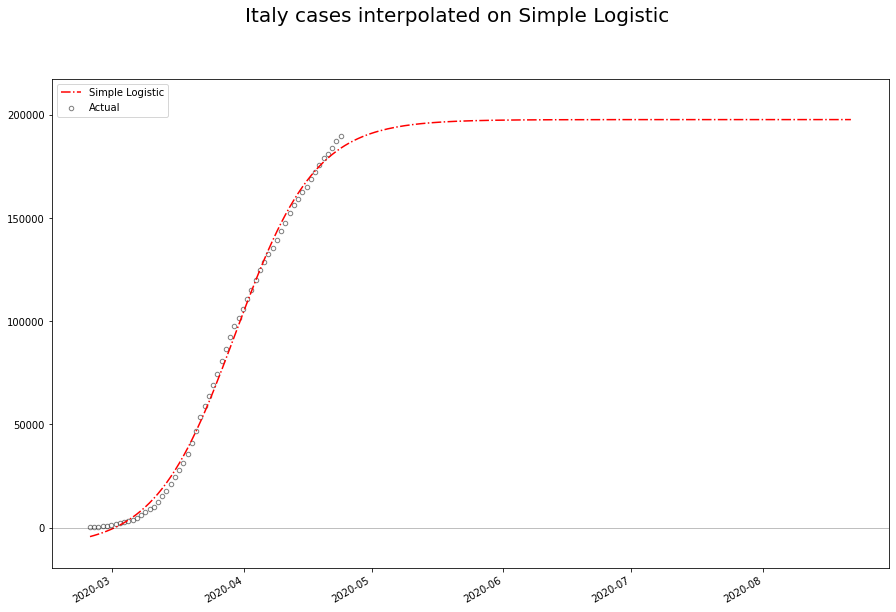

In [17]:
original, interpolated, popt, logit1, logit2 = prepare_cases(data, forecast=120, method="logit")
plot_function(original, interpolated, name="Italy", method="Simple Logistic")

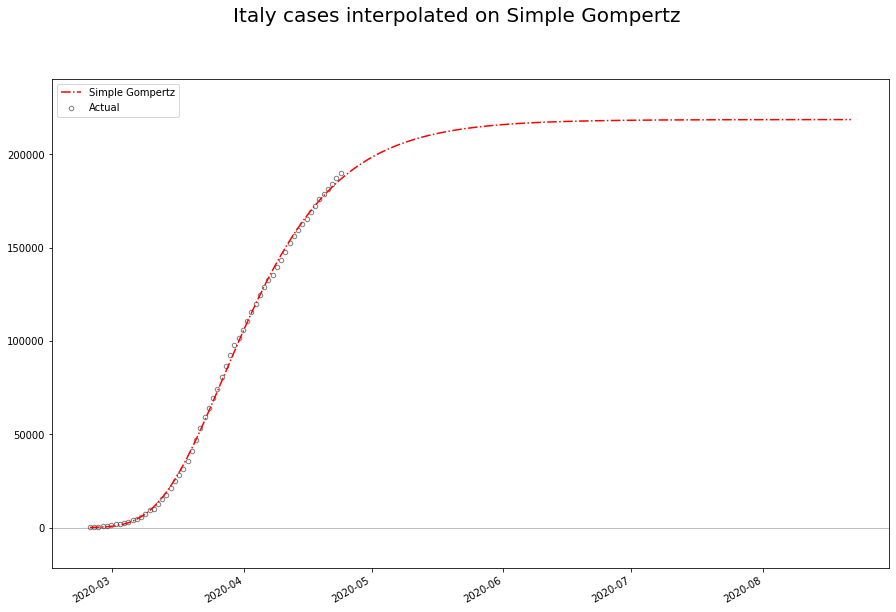

In [18]:
original, interpolated, popt, logit1, logit2 = prepare_cases(data, forecast=120, method="gomp")
plot_function(original, interpolated, name="Italy", method="Simple Gompertz")

Si decide di:
- Considerare arbitrariamente nazioni con più di 100 infetti, al fine avere un minimo base di dati a disposizione
- tentare una prima interpolazione sui dati grezzi tutte le nazioni scelte con `curve_fit` con metodo `dogbox` di `scipy` in python su
  - logistica semplice (Logit)
  - logistica doppia (DobLog)
  - Gompertz semplice (Gomp)
  - Gompertz doppia (DobGomp)
- rigettare le interpolazioni fallite per errori del modulo `curve_fit`
- Valutare la bontà dell'interpolazione sui dati tramite funzione `linregress` di `scipy`

I dati saranno presi dall'archivio della Johns Hopkins University ([ref]()), raggruppandoli per nazione ([ref]()).

In [19]:
url = 'https://raw.githubusercontent.com/maxdevblock/covid-19-time-series/master/json/COVID-COUNTRIES.json'
with urllib.request.urlopen(url) as _url:
    _data = json.loads(_url.read().decode())

In [20]:
LIMIT = 100
ok_countries = []
print(f"TOTALE NAZIONI: {len(_data)}")
for country in _data:
    data = get_df(_data, country)
    if max(data) < LIMIT:
        print(f"\033[31mNon compatibile: {country}, INFETTI: {max(data)} < {LIMIT}\033[0m")
    else:
        print(f"\033[32mCompatibile: {country}, INFETTI: {max(data)}\033[0m")
        ok_countries.append(country)
print(f"ACCETTATE {len(ok_countries)} NAZIONI")

TOTALE NAZIONI: 185
Compatibile: Afghanistan, INFETTI: 1176
Compatibile: Albania, INFETTI: 634
Compatibile: Algeria, INFETTI: 2910
Compatibile: Andorra, INFETTI: 723
Non compatibile: Angola, INFETTI: 25 < 100
Non compatibile: Antigua and Barbuda, INFETTI: 24 < 100
Compatibile: Argentina, INFETTI: 3144
Compatibile: Armenia, INFETTI: 1473
Compatibile: Australia, INFETTI: 6547
Compatibile: Austria, INFETTI: 14925
Compatibile: Azerbaijan, INFETTI: 1518
Non compatibile: Bahamas, INFETTI: 65 < 100
Compatibile: Bahrain, INFETTI: 2027
Compatibile: Bangladesh, INFETTI: 3772
Non compatibile: Barbados, INFETTI: 75 < 100
Compatibile: Belarus, INFETTI: 7281
Compatibile: Belgium, INFETTI: 41889
Non compatibile: Belize, INFETTI: 18 < 100
Non compatibile: Benin, INFETTI: 54 < 100
Non compatibile: Bhutan, INFETTI: 6 < 100
Compatibile: Bolivia, INFETTI: 609
Compatibile: Bosnia and Herzegovina, INFETTI: 1368
Non compatibile: Botswana, INFETTI: 22 < 100
Compatibile: Brazil, INFETTI: 45757
Compatibile: Bru

In [21]:
total_results = {
    "Function": [],
    "Nations": [],
    "Days": [],
    "Samples": [],
    "Slope": [],
    "Intercept": [],
    "Rho": [],
    "p-value": [],
    "Std Err": []
}

# Interpolazione di Gompertz Doppia

In [22]:
final_results = {}
errors = []

for country in ok_countries:
    data = get_df(_data, country)
    try:
        original, interp, popt, logit1, logit2 = prepare_cases(data, forecast=0, country=country, method="dobgomp")
        final_results.update({
            country: {"original": original,"gompertz": interp}
        })
    except Exception as err:
        print(f"\033[43m{country} ERROR: {err}\033[0m")
        errors.append(country)
        
clear_output(wait=True)

print(f"NAZIONI PROCESSATE: {len(ok_countries)}")

print(f"\033[1;32mNAZIONI PROCESSATE CORRETTAMENTE: {len(final_results)}\033[0m")
#print("\033[32m{}\033[0m".format("\n".join(final_results.keys())))

print(f"\033[1;31mNAZIONI CON ERRORI: {len(errors)}\033[0m")
#print("\033[31m{}\033[0m".format("\n".join(errors)))

print(f"NAZIONI FINALI: {len(final_results)}")

NAZIONI PROCESSATE: 132
NAZIONI PROCESSATE CORRETTAMENTE: 127
NAZIONI CON ERRORI: 5
NAZIONI FINALI: 127


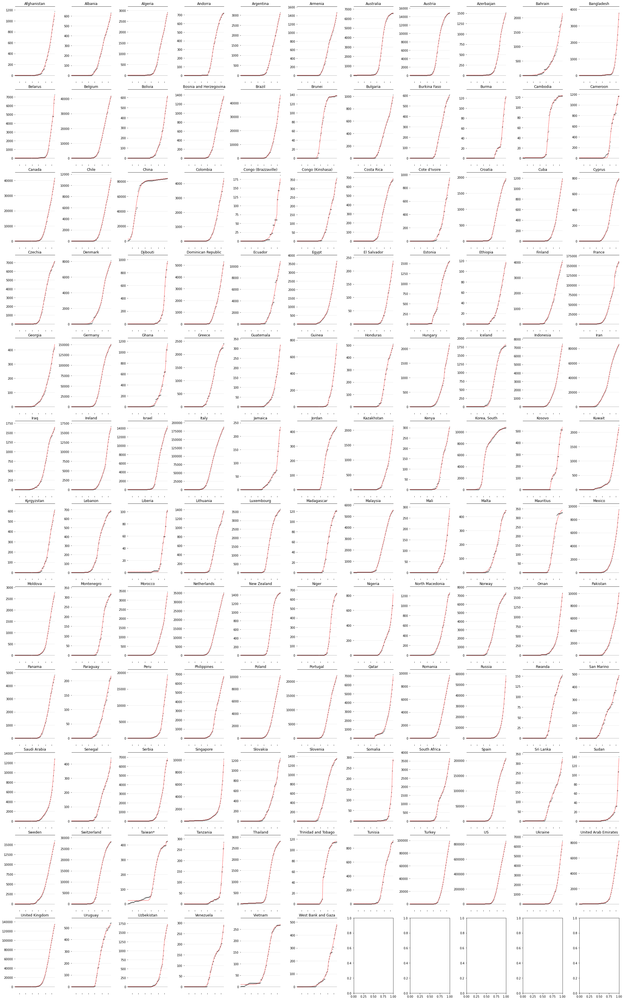

In [23]:
ncols = 11
nrows = int(np.ceil(len(final_results) / ncols))

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(30, nrows * 4))

for i, country in enumerate(final_results):
    try:
        plot_gompertz_mini(
            final_results[country]["original"],
            final_results[country]["gompertz"],
            axes.flat[i], name=country)
    except Exception as err:
        print(f"\033[43m{country} ERROR: {err}\033[0m")

fig.tight_layout()
fig.set_facecolor('w')

In [24]:
RSD = {"country": [], "slope": [], "intercept": [], "r_value": [], "p_value": [], "std_err": []}
for i, country in enumerate(final_results):
    slope, intercept, r_value, p_value, std_err = stats.linregress(
        final_results[country]["original"][:len(final_results[country]["original"])],
        final_results[country]["gompertz"][:len(final_results[country]["original"])]
    )
    RSD["country"].append(country)
    RSD["slope"].append(slope)
    RSD["intercept"].append(intercept)
    RSD["r_value"].append(r_value)
    RSD["p_value"].append(p_value)
    RSD["std_err"].append(std_err)

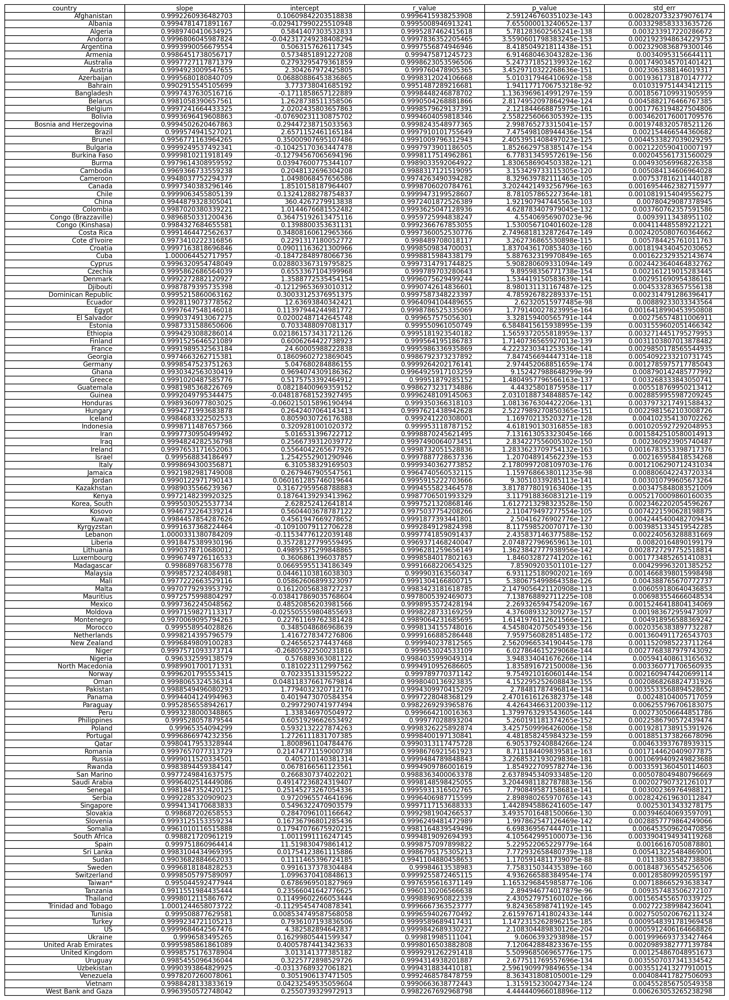

In [25]:
RSDdf = pd.DataFrame(data=RSD)
# display(HTML(RSDdf.to_html(notebook=True, col_space=100)))
plt.figure(figsize=(20, 6), dpi=200,)
cell_text = []
for row in range(len(RSDdf)):
    cell_text.append(RSDdf.iloc[row])
plt.table(cellText=cell_text, colLabels=RSDdf.columns, loc='center')
plt.axis('off')
plt.show()

In [26]:
mean_slope = np.mean(RSDdf['slope'])
mean_intercept = np.mean(RSDdf['intercept'])
mean_r_value = np.mean(RSDdf['r_value'])
mean_p_value = np.mean(RSDdf['p_value'])
mean_std_err = np.mean(RSDdf['std_err'])

In [27]:
print("TOTAL nations {}".format(RSDdf["country"].size))
print("TOTAL samples per nation: {}".format(len(final_results[country]["original"])))
print("TOTAL samples: {}".format(RSDdf["country"].size * len(final_results[country]["original"])))
print("----------------------------")
print(f"Mean Slope: {mean_slope:.6f}")
print(f"Mean Intercept: {mean_intercept:.6f}")
print(f"Mean R: {mean_r_value:.6f}")
print(f"Mean P: {mean_p_value:.2E}")
print(f"Mean Std Err: {mean_std_err:.6f}")

TOTAL nations 127
TOTAL samples per nation: 92
TOTAL samples: 11684
----------------------------
Mean Slope: 0.998413
Mean Intercept: 3.852683
Mean R: 0.999223
Mean P: 9.22E-91
Mean Std Err: 0.003519


In [28]:
total_results["Function"].append("Double Gompertz")
total_results["Nations"].append(RSDdf["country"].size)
total_results["Days"].append(len(final_results[country]["original"]))
total_results["Samples"].append(RSDdf["country"].size * len(final_results[country]["original"]))
total_results["Slope"].append(mean_slope)
total_results["Intercept"].append(mean_intercept)
total_results["Rho"].append(mean_r_value)
total_results["p-value"].append(mean_p_value)
total_results["Std Err"].append(mean_std_err)

# Interpolazione su Logistica Doppia

In [29]:
final_results = {}
errors = []

for country in ok_countries:
    data = get_df(_data, country)
    try:
        original, interp, popt, logit1, logit2 = prepare_cases(data, forecast=0, country=country, method="doblogit")
        final_results.update({
            country: {"original": original,"doblogit": interp}
        })
    except Exception as err:
        print(f"\033[43m{country} ERROR: {err}\033[0m")
        errors.append(country)
        
clear_output(wait=True)

print(f"NAZIONI PROCESSATE: {len(ok_countries)}")

print(f"\033[1;32mNAZIONI PROCESSATE CORRETTAMENTE: {len(final_results)}\033[0m")
#print("\033[32m{}\033[0m".format("\n".join(final_results.keys())))

print(f"\033[1;31mNAZIONI CON ERRORI: {len(errors)}\033[0m")
#print("\033[31m{}\033[0m".format("\n".join(errors)))

print(f"NAZIONI FINALI: {len(final_results)}")

NAZIONI PROCESSATE: 132
NAZIONI PROCESSATE CORRETTAMENTE: 129
NAZIONI CON ERRORI: 3
NAZIONI FINALI: 129


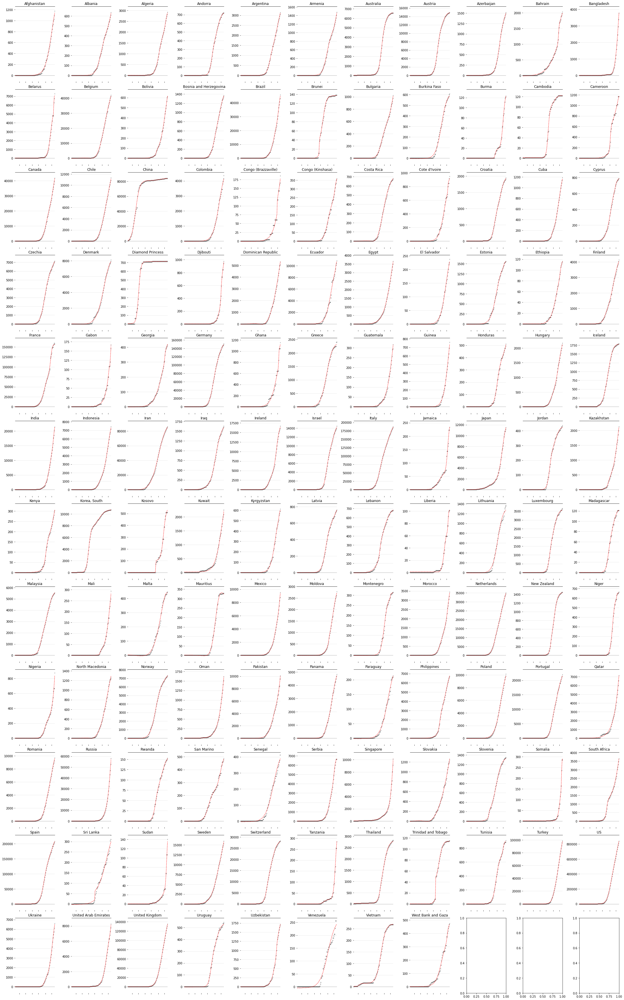

In [30]:
ncols = 11
nrows = int(np.ceil(len(final_results) / ncols))

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(30, nrows * 4))

for i, country in enumerate(final_results):
    try:
        plot_gompertz_mini(
            final_results[country]["original"],
            final_results[country]["doblogit"],
            axes.flat[i], name=country)
    except Exception as err:
        print(f"\033[43m{country} ERROR: {err}\033[0m")

fig.tight_layout()
fig.set_facecolor('w')

In [31]:
RSD = {"country": [], "slope": [], "intercept": [], "r_value": [], "p_value": [], "std_err": []}
for i, country in enumerate(final_results):
    slope, intercept, r_value, p_value, std_err = stats.linregress(
        final_results[country]["original"][:len(final_results[country]["original"])],
        final_results[country]["doblogit"][:len(final_results[country]["original"])]
    )
    RSD["country"].append(country)
    RSD["slope"].append(slope)
    RSD["intercept"].append(intercept)
    RSD["r_value"].append(r_value)
    RSD["p_value"].append(p_value)
    RSD["std_err"].append(std_err)

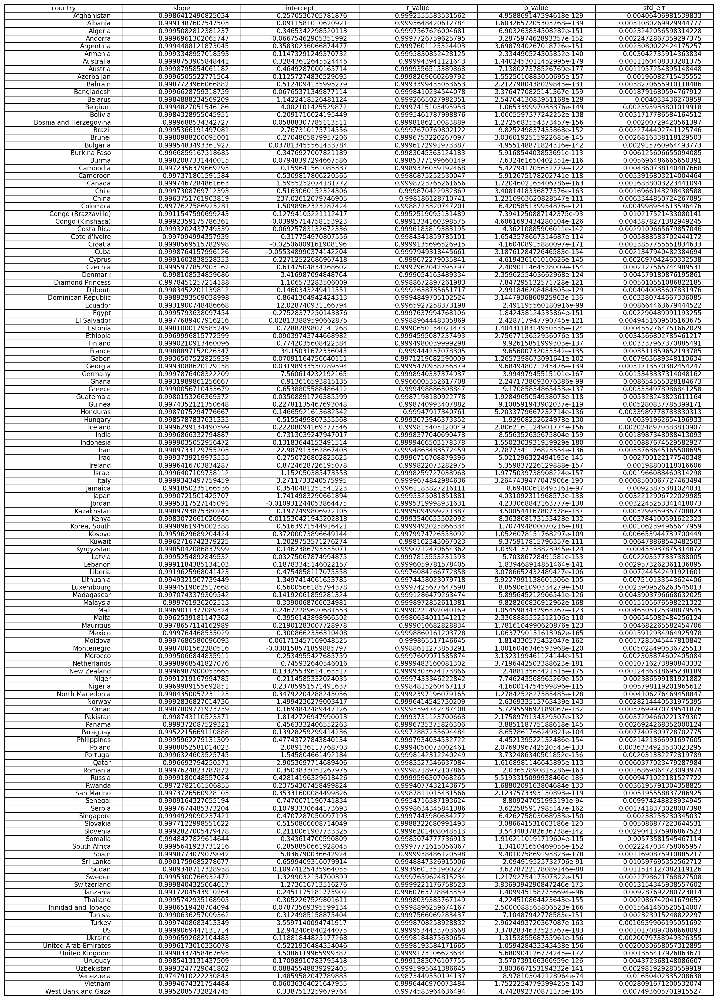

In [32]:
RSDdf = pd.DataFrame(data=RSD)
# display(HTML(RSDdf.to_html(notebook=True, col_space=100)))
plt.figure(figsize=(20, 6), dpi=200,)
cell_text = []
for row in range(len(RSDdf)):
    cell_text.append(RSDdf.iloc[row])
plt.table(cellText=cell_text, colLabels=RSDdf.columns, loc='center')
plt.axis('off')
plt.show()

In [33]:
mean_slope = np.mean(RSDdf['slope'])
mean_intercept = np.mean(RSDdf['intercept'])
mean_r_value = np.mean(RSDdf['r_value'])
mean_p_value = np.mean(RSDdf['p_value'])
mean_std_err = np.mean(RSDdf['std_err'])

In [34]:
print("TOTAL nations {}".format(RSDdf["country"].size))
print("TOTAL samples per nation: {}".format(len(final_results[country]["original"])))
print("TOTAL samples: {}".format(RSDdf["country"].size * len(final_results[country]["original"])))
print("----------------------------")
print(f"Mean Slope: {mean_slope:.6f}")
print(f"Mean Intercept: {mean_intercept:.6f}")
print(f"Mean R: {mean_r_value:.6f}")
print(f"Mean P: {mean_p_value:.2E}")
print(f"Mean Std Err: {mean_std_err:.6f}")

TOTAL nations 129
TOTAL samples per nation: 92
TOTAL samples: 11868
----------------------------
Mean Slope: 0.998028
Mean Intercept: 3.149797
Mean R: 0.999045
Mean P: 6.96E-76
Mean Std Err: 0.003819


In [35]:
total_results["Function"].append("Double Logistic")
total_results["Nations"].append(RSDdf["country"].size)
total_results["Days"].append(len(final_results[country]["original"]))
total_results["Samples"].append(RSDdf["country"].size * len(final_results[country]["original"]))
total_results["Slope"].append(mean_slope)
total_results["Intercept"].append(mean_intercept)
total_results["Rho"].append(mean_r_value)
total_results["p-value"].append(mean_p_value)
total_results["Std Err"].append(mean_std_err)

# Interpolazione su Logistica semplice

In [36]:
final_results = {}
errors = []

for country in ok_countries:
    data = get_df(_data, country)
    try:
        original, interp, popt, logit1, logit2 = prepare_cases(data, forecast=0, country=country, method="logit")
        final_results.update({
            country: {"original": original,"logit": interp}
        })
    except Exception as err:
        print(f"\033[43m{country} ERROR: {err}\033[0m")
        errors.append(country)
        
clear_output(wait=True)

print(f"NAZIONI PROCESSATE: {len(ok_countries)}")

print(f"\033[1;32mNAZIONI PROCESSATE CORRETTAMENTE: {len(final_results)}\033[0m")
#print("\033[32m{}\033[0m".format("\n".join(final_results.keys())))

print(f"\033[1;31mNAZIONI CON ERRORI: {len(errors)}\033[0m")
#print("\033[31m{}\033[0m".format("\n".join(errors)))

print(f"NAZIONI FINALI: {len(final_results)}")

NAZIONI PROCESSATE: 132
NAZIONI PROCESSATE CORRETTAMENTE: 132
NAZIONI CON ERRORI: 0
NAZIONI FINALI: 132


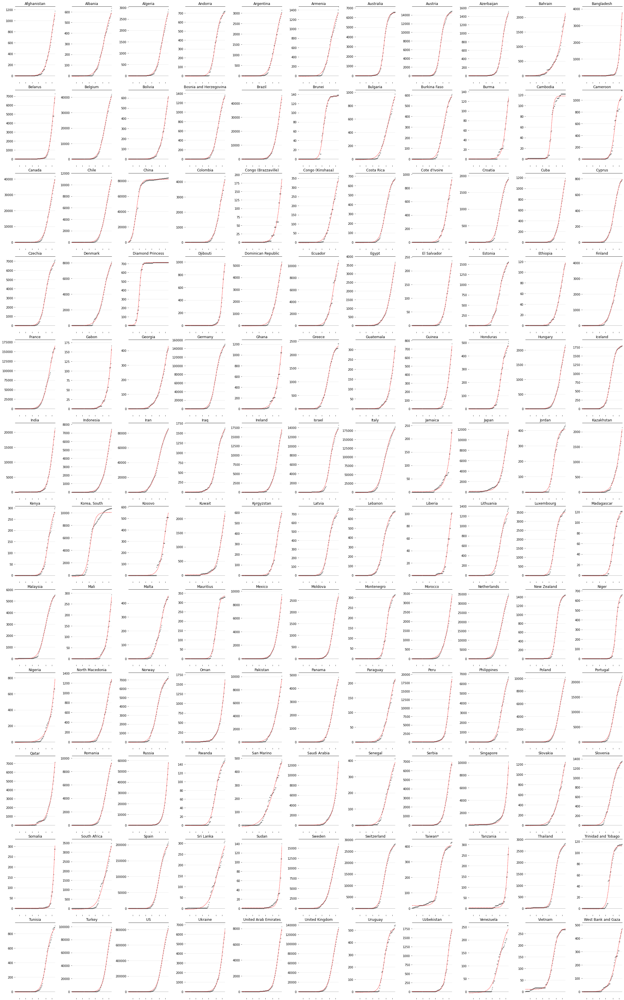

In [37]:
ncols = 11
nrows = int(np.ceil(len(final_results) / ncols))

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(30, nrows * 4))

for i, country in enumerate(final_results):
    try:
        plot_gompertz_mini(
            final_results[country]["original"],
            final_results[country]["logit"],
            axes.flat[i], name=country)
    except Exception as err:
        print(f"\033[43m{country} ERROR: {err}\033[0m")

fig.tight_layout()
fig.set_facecolor('w')

In [38]:
RSD = {"country": [], "slope": [], "intercept": [], "r_value": [], "p_value": [], "std_err": []}
for i, country in enumerate(final_results):
    slope, intercept, r_value, p_value, std_err = stats.linregress(
        final_results[country]["original"][:len(final_results[country]["original"])],
        final_results[country]["logit"][:len(final_results[country]["original"])]
    )
    RSD["country"].append(country)
    RSD["slope"].append(slope)
    RSD["intercept"].append(intercept)
    RSD["r_value"].append(r_value)
    RSD["p_value"].append(p_value)
    RSD["std_err"].append(std_err)

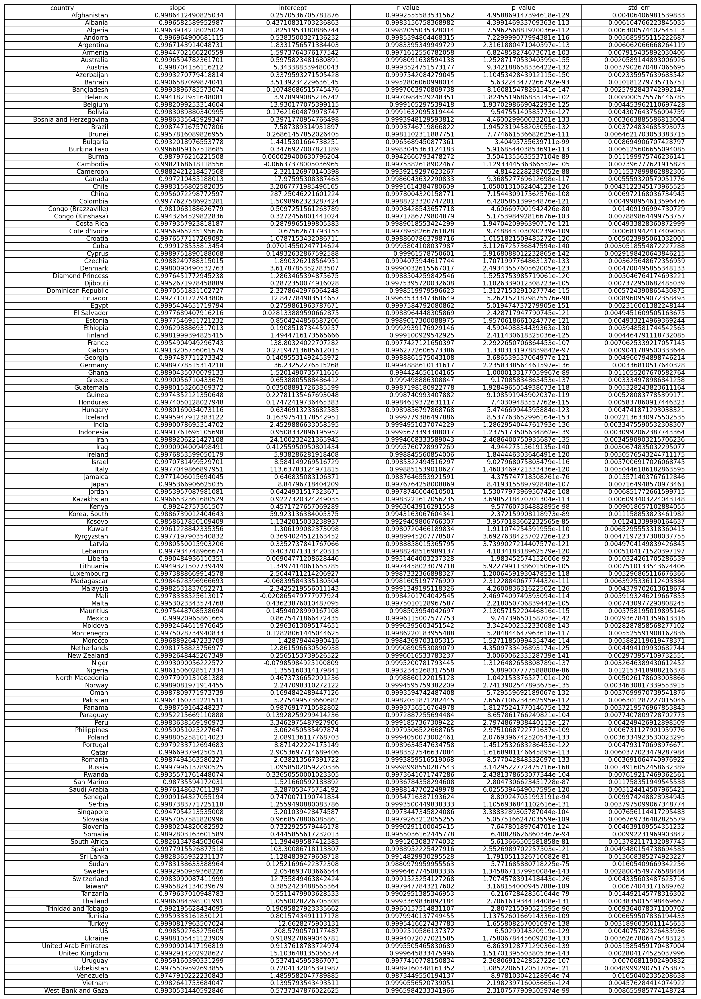

In [39]:
RSDdf = pd.DataFrame(data=RSD)
# display(HTML(RSDdf.to_html(notebook=True, col_space=100)))
plt.figure(figsize=(20, 6), dpi=200,)
cell_text = []
for row in range(len(RSDdf)):
    cell_text.append(RSDdf.iloc[row])
plt.table(cellText=cell_text, colLabels=RSDdf.columns, loc='center')
plt.axis('off')
plt.show()

In [40]:
mean_slope = np.mean(RSDdf['slope'])
mean_intercept = np.mean(RSDdf['intercept'])
mean_r_value = np.mean(RSDdf['r_value'])
mean_p_value = np.mean(RSDdf['p_value'])
mean_std_err = np.mean(RSDdf['std_err'])

In [41]:
print("TOTAL nations {}".format(RSDdf["country"].size))
print("TOTAL samples per nation: {}".format(len(final_results[country]["original"])))
print("TOTAL samples: {}".format(RSDdf["country"].size * len(final_results[country]["original"])))
print("----------------------------")
print(f"Mean Slope: {mean_slope:.6f}")
print(f"Mean Intercept: {mean_intercept:.6f}")
print(f"Mean R: {mean_r_value:.6f}")
print(f"Mean P: {mean_p_value:.2E}")
print(f"Mean Std Err: {mean_std_err:.6f}")

TOTAL nations 132
TOTAL samples per nation: 92
TOTAL samples: 12144
----------------------------
Mean Slope: 0.995687
Mean Intercept: 9.419208
Mean R: 0.997833
Mean P: 7.27E-76
Mean Std Err: 0.006152


In [42]:
total_results["Function"].append("Logistic Simple")
total_results["Nations"].append(RSDdf["country"].size)
total_results["Days"].append(len(final_results[country]["original"]))
total_results["Samples"].append(RSDdf["country"].size * len(final_results[country]["original"]))
total_results["Slope"].append(mean_slope)
total_results["Intercept"].append(mean_intercept)
total_results["Rho"].append(mean_r_value)
total_results["p-value"].append(mean_p_value)
total_results["Std Err"].append(mean_std_err)

# Interpolazione su Gompertz semplice

In [43]:
final_results = {}
errors = []

for country in ok_countries:
    data = get_df(_data, country)
    try:
        original, interp, popt, logit1, logit2 = prepare_cases(data, forecast=0, country=country, method="gomp")
        final_results.update({
            country: {"original": original,"gomp": interp}
        })
    except Exception as err:
        print(f"\033[43m{country} ERROR: {err}\033[0m")
        errors.append(country)
        
clear_output(wait=True)

print(f"NAZIONI PROCESSATE: {len(ok_countries)}")

print(f"\033[1;32mNAZIONI PROCESSATE CORRETTAMENTE: {len(final_results)}\033[0m")
#print("\033[32m{}\033[0m".format("\n".join(final_results.keys())))

print(f"\033[1;31mNAZIONI CON ERRORI: {len(errors)}\033[0m")
#print("\033[31m{}\033[0m".format("\n".join(errors)))

print(f"NAZIONI FINALI: {len(final_results)}")

NAZIONI PROCESSATE: 132
NAZIONI PROCESSATE CORRETTAMENTE: 125
NAZIONI CON ERRORI: 7
NAZIONI FINALI: 125


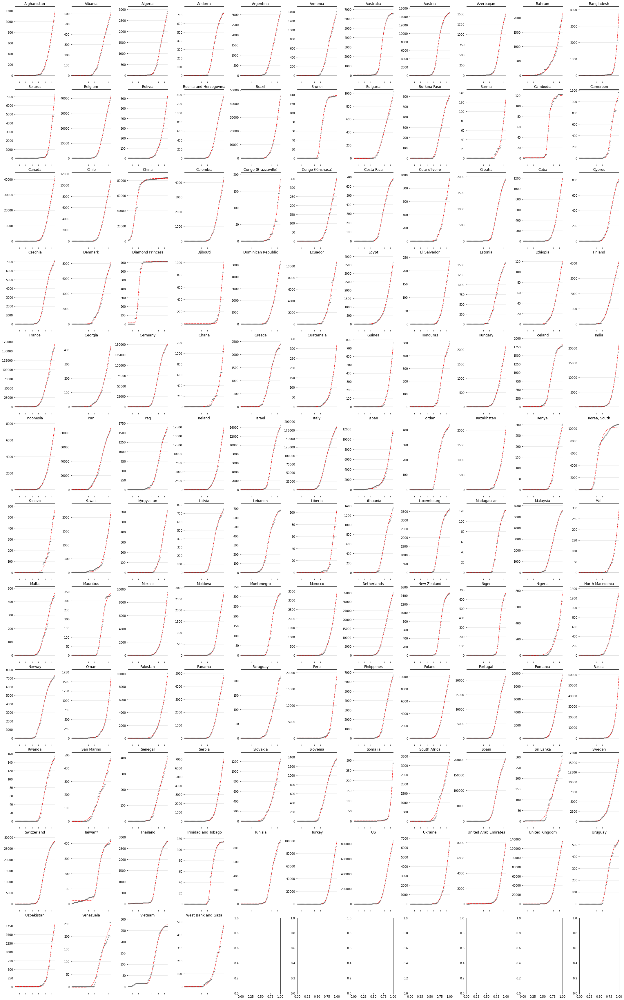

In [44]:
ncols = 11
nrows = int(np.ceil(len(final_results) / ncols))

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(30, nrows * 4))

for i, country in enumerate(final_results):
    try:
        plot_gompertz_mini(
            final_results[country]["original"],
            final_results[country]["gomp"],
            axes.flat[i], name=country)
    except Exception as err:
        print(f"\033[43m{country} ERROR: {err}\033[0m")

fig.tight_layout()
fig.set_facecolor('w')

In [45]:
RSD = {"country": [], "slope": [], "intercept": [], "r_value": [], "p_value": [], "std_err": []}
for i, country in enumerate(final_results):
    slope, intercept, r_value, p_value, std_err = stats.linregress(
        final_results[country]["original"][:len(final_results[country]["original"])],
        final_results[country]["gomp"][:len(final_results[country]["original"])]
    )
    RSD["country"].append(country)
    RSD["slope"].append(slope)
    RSD["intercept"].append(intercept)
    RSD["r_value"].append(r_value)
    RSD["p_value"].append(p_value)
    RSD["std_err"].append(std_err)

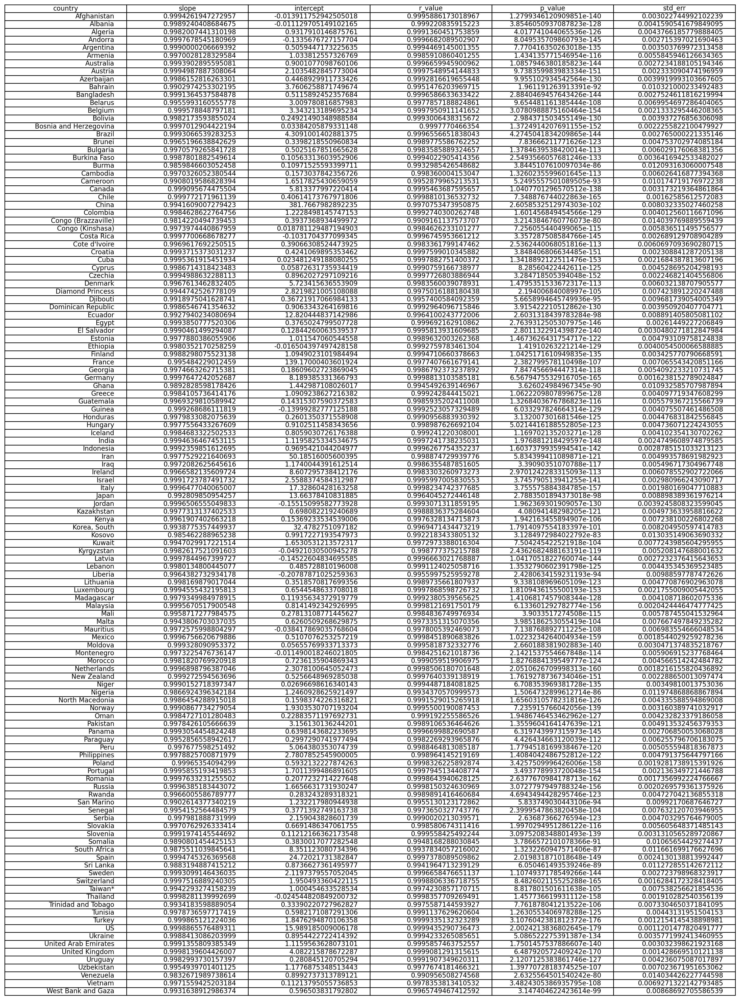

In [46]:
RSDdf = pd.DataFrame(data=RSD)
# display(HTML(RSDdf.to_html(notebook=True, col_space=100)))
plt.figure(figsize=(20, 6), dpi=200,)
cell_text = []
for row in range(len(RSDdf)):
    cell_text.append(RSDdf.iloc[row])
plt.table(cellText=cell_text, colLabels=RSDdf.columns, loc='center')
plt.axis('off')
plt.show()

In [47]:
mean_slope = np.mean(RSDdf['slope'])
mean_intercept = np.mean(RSDdf['intercept'])
mean_r_value = np.mean(RSDdf['r_value'])
mean_p_value = np.mean(RSDdf['p_value'])
mean_std_err = np.mean(RSDdf['std_err'])

In [48]:
print("TOTAL nations {}".format(RSDdf["country"].size))
print("TOTAL samples per nation: {}".format(len(final_results[country]["original"])))
print("TOTAL samples: {}".format(RSDdf["country"].size * len(final_results[country]["original"])))
print("----------------------------")
print(f"Mean Slope: {mean_slope:.6f}")
print(f"Mean Intercept: {mean_intercept:.6f}")
print(f"Mean R: {mean_r_value:.6f}")
print(f"Mean P: {mean_p_value:.2E}")
print(f"Mean Std Err: {mean_std_err:.6f}")

TOTAL nations 125
TOTAL samples per nation: 92
TOTAL samples: 11500
----------------------------
Mean Slope: 0.996940
Mean Intercept: 6.581740
Mean R: 0.998444
Mean P: 4.68E-82
Mean Std Err: 0.005059


In [49]:
total_results["Function"].append("Gompertz Simple")
total_results["Nations"].append(RSDdf["country"].size)
total_results["Days"].append(len(final_results[country]["original"]))
total_results["Samples"].append(RSDdf["country"].size * len(final_results[country]["original"]))
total_results["Slope"].append(mean_slope)
total_results["Intercept"].append(mean_intercept)
total_results["Rho"].append(mean_r_value)
total_results["p-value"].append(mean_p_value)
total_results["Std Err"].append(mean_std_err)

# Comparazione funzioni

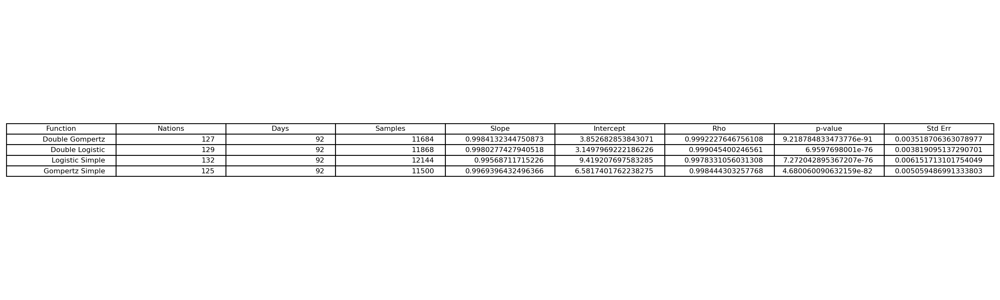

In [50]:
TOTdf = pd.DataFrame(data=total_results)
# display(HTML(TOTdf.to_html(notebook=True, col_space=90, index=False)))
plt.figure(figsize=(20, 6), dpi=200,)
cell_text = []
for row in range(len(TOTdf)):
    cell_text.append(TOTdf.iloc[row])
plt.table(cellText=cell_text, colLabels=TOTdf.columns, loc='center')
plt.axis('off')
plt.show()